In [33]:
import numpy as np
import pandas as pd
import librosa
import soundfile as sf
import numpy as np
import os
import glob
import pickle
import wave
import sys
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy import signal
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

In [11]:
def loading_audio_data():
    x = []
    y = []
    for file in glob.glob("C:\\Users\\Vaibhav K\\Documents\\Data Science Project\\RES\\Dataset\\Actor_*\\*.wav"):
        file_path=os.path.basename(file)
        emotion = emotion_labels[file_path.split("-")[2]]
        if emotion not in focused_emotion_labels:
            continue
        feature = audio_features(file, mfcc=True, chroma=True, mel=True)
        
        x.append(feature)
        y.append(emotion)
    final_dataset = train_test_split(np.array(x), y, test_size=0.1, random_state=9)
    return final_dataset

In [12]:
len(os.listdir('C:\\Users\\Vaibhav K\\Documents\\Data Science Project\\RES\\Dataset\\'))

24

In [13]:
os.listdir(path='.\Dataset')
def getListOfFiles(dirName):
    listOfFile=os.listdir(dirName)
    allFiles=list()
    for entry in listOfFile:
        fullPath=os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles=allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

dirName = './Dataset'
listOfFiles = getListOfFiles(dirName)
len(listOfFiles)

1440

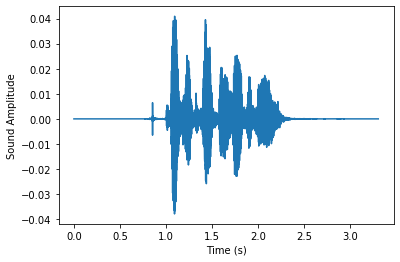

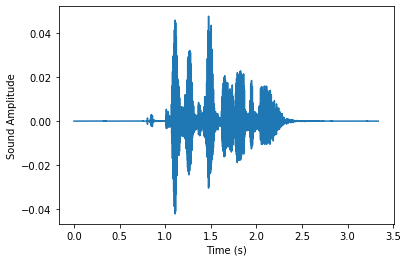

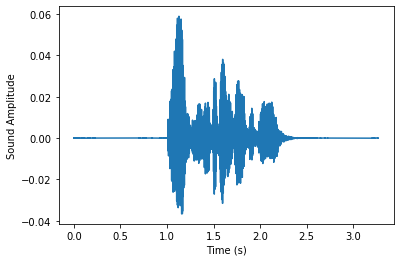

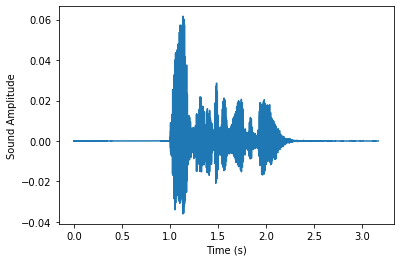

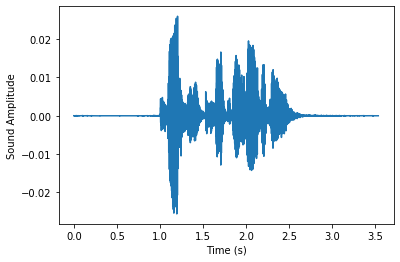

...

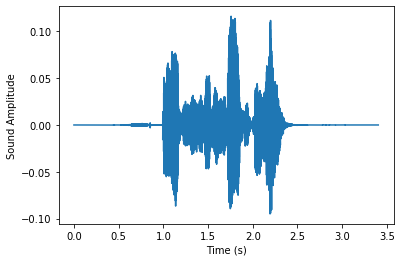

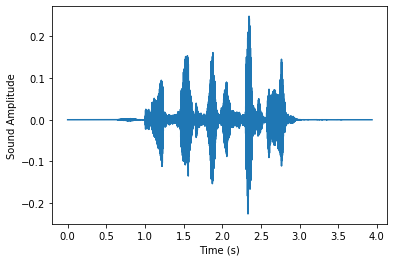

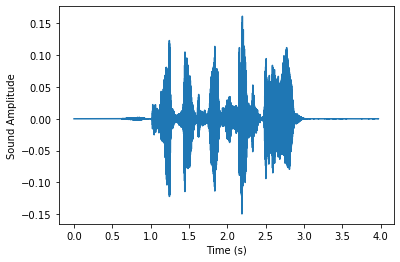

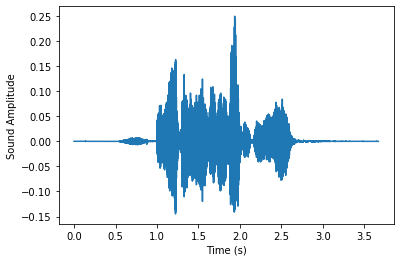

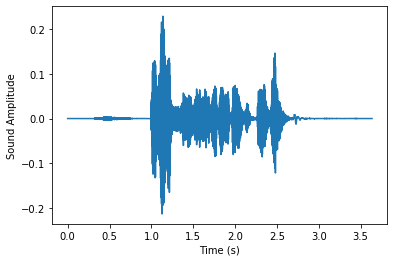

NameError: name 'wavfile' is not defined

In [40]:
#Plotting the Basic Graphs for understanding of Audio Files :
import librosa as lr
for file in range(0 , len(listOfFiles) , 1):
    audio , sfreq = lr.load(listOfFiles[file])
    time = np.arange(0 , len(audio)) / sfreq
    
    fig ,ax = plt.subplots()
    ax.plot(time , audio)
    ax.set(xlabel = 'Time (s)' , ylabel = 'Sound Amplitude')
    plt.show()
    
#PLOT THE SEPCTOGRAM
for file in range(0 , len(listOfFiles) , 1):
     sample_rate , samples = wavfile.read(listOfFiles[file])
     frequencies , times, spectrogram = signal.spectrogram(samples, sample_rate) 
     plt.pcolormesh(times, frequencies, spectrogram)
     plt.imshow(spectrogram)
     plt.ylabel('Frequency [Hz]')
     plt.xlabel('Time [sec]')
     plt.show()

In [14]:
def audio_features(file_title, mfcc, chroma, mel):
    with sf.SoundFile(file_title) as audio_recording:
        audio = audio_recording.read(dtype="float32")
        sample_rate = audio_recording.samplerate
        
        if chroma:
            stft=np.abs(lb.stft(audio))
            result=np.array([])
        if mfcc:
            mfccs=np.mean(lb.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40).T, axis=0)
            result=np.hstack((result, mfccs))
        if chroma:
            chroma=np.mean(lb.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
            result=np.hstack((result, chroma))
        if mel:
            mel=np.mean(lb.feature.melspectrogram(audio, sr=sample_rate).T,axis=0)
            result=np.hstack((result, mel))
        return result

In [17]:
emotion_labels = {
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}

focused_emotion_labels = ['happy', 'sad', 'angry']

In [18]:
X_train, X_test, y_train, y_test = loading_audio_data()

In [19]:
#Get the shape of the training and testing datasets
#print((x_train.shape[0], x_test.shape[0]))
print((X_train[0], X_test[0]))
#Get the number of features extracted
print(f'Features extracted: {X_train.shape[1]}')

(array([-5.13774902e+02,  1.78634129e+01, -3.07672577e+01, -3.27121735e+00,
       -2.41373901e+01, -2.16548214e+01, -1.73873234e+01, -2.74172268e+01,
       -6.57045794e+00, -5.56371737e+00, -4.93007374e+00,  1.14783716e+00,
       -1.97311985e+00,  8.58952999e+00, -1.96984446e+00,  9.85629082e+00,
        4.67952442e+00, -6.29155159e-01, -2.81489110e+00, -2.08578873e+00,
       -4.35390949e+00,  2.53143668e+00, -3.58957362e+00, -2.36873603e+00,
       -1.50159180e+00, -5.61194956e-01, -2.74505407e-01,  7.80659616e-01,
       -7.81586289e-01,  7.85898089e-01,  6.00222468e-01,  6.93827152e-01,
        8.10553074e-01,  2.05018020e+00,  7.89618492e-01, -2.70711446e+00,
        2.99704403e-01,  1.79746553e-01, -3.89937520e-01, -1.34274793e+00,
        4.83829588e-01,  4.72257465e-01,  4.79856044e-01,  4.75644797e-01,
        5.27464449e-01,  5.26072919e-01,  5.21776199e-01,  5.75649321e-01,
        5.71917713e-01,  5.48399329e-01,  5.09127498e-01,  4.93285686e-01,
        1.91791082e-06, 

In [20]:
#Initialize Multi Layer Perception Classifier
model = MLPClassifier(hidden_layer_sizes=(200,), learning_rate='adaptive', max_iter=400)

In [23]:
#Train the model
model.fit(X_train,y_train)

MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=(200,), learning_rate='adaptive',
              learning_rate_init=0.001, max_fun=15000, max_iter=400,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=None, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=False,
              warm_start=False)

In [22]:
#Model prediction accuracy score
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_true=y_test, y_pred=y_pred)
print("Accuracy of the Recognizer is: {:.1f}%".format(accuracy*100))

Accuracy of the Recognizer is: 82.8%


In [24]:
#SAVING THE MODEL
import pickle
# Save the Modle to file in the current working directory
#For any new testing data other than the data in dataset

Pkl_Filename = "Emotion_Voice_Detection_Model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

In [25]:
# Load the Model back from file
with open(Pkl_Filename, 'rb') as file:  
    Emotion_Voice_Detection_Model = pickle.load(file)

Emotion_Voice_Detection_Model

MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=False, epsilon=1e-08,
              hidden_layer_sizes=(200,), learning_rate='adaptive',
              learning_rate_init=0.001, max_fun=15000, max_iter=400,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=None, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=False,
              warm_start=False)

In [27]:
#predicting :
y_pred=Emotion_Voice_Detection_Model.predict(X_test)
y_pred

array(['angry', 'angry', 'angry', 'happy', 'happy', 'happy', 'happy',
       'happy', 'angry', 'happy', 'happy', 'angry', 'sad', 'happy',
       'angry', 'happy', 'sad', 'happy', 'sad', 'angry', 'sad', 'happy',
       'angry', 'angry', 'sad', 'happy', 'angry', 'happy', 'angry',
       'angry', 'angry', 'happy', 'angry', 'sad', 'angry', 'angry', 'sad',
       'happy', 'sad', 'sad', 'sad', 'angry', 'angry', 'angry', 'sad',
       'happy', 'sad', 'happy', 'sad', 'happy', 'angry', 'happy', 'happy',
       'angry', 'angry', 'sad', 'angry', 'sad'], dtype='<U5')

In [32]:
#Store the Prediction probabilities into CSV file 
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

   predictions
0        angry
1        angry
2        angry
3        happy
4        happy
5        happy
6        happy
7        happy
8        angry
9        happy
10       happy
11       angry
12         sad
13       happy
14       angry
15       happy
16         sad
17       happy
18         sad
19       angry
20         sad
21       happy
22       angry
23       angry
24         sad
25       happy
26       angry
27       happy
28       angry
29       angry
30       angry
31       happy
32       angry
33         sad
34       angry
35       angry
36         sad
37       happy
38         sad
39         sad
40         sad
41       angry
42       angry
43       angry
44         sad
45       happy
46         sad
47       happy
48         sad
49       happy
50       angry
51       happy
52       happy
53       angry
54       angry
55         sad
56       angry
57         sad
